# Camera Calibration

(720, 1280, 3)
255
0


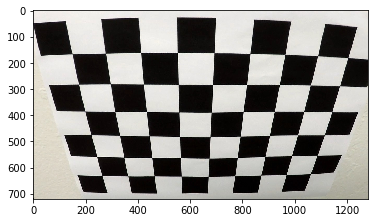

In [1]:
# Plotting one of the image of the camera calibration image set for analysis

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

%matplotlib inline

img = mpimg.imread('camera_cal\calibration2.jpg')
plt.imshow(img)

print(img.shape)
print(np.max(img))
print(np.min(img))

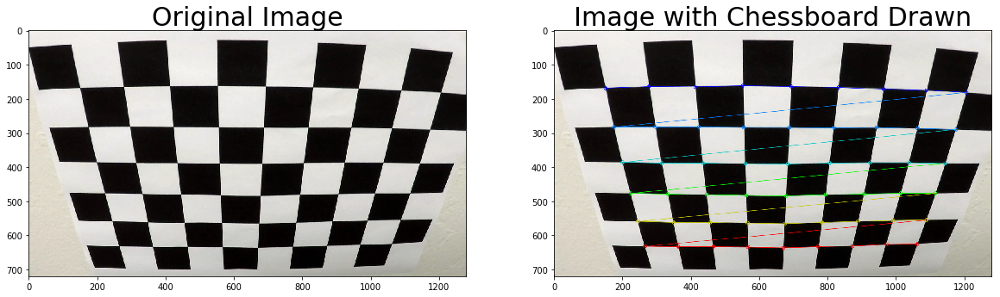

In [2]:
# Find and Draw Chessboard on the sample image

img1 = np.copy(img)

imgpoints = [] # 2D points in image plane
objpoints = [] # 3D points in real space

objp = np.zeros((6*9,3), dtype=np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
#print(objp)

gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#plt.imshow(gray, cmap="gray")

ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
#print(ret)
#print(corners.shape)

if ret == True:
    imgpoints.append(corners)
    objpoints.append(objp)
    
    img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
    #plt.imshow(img1)
    
# Visualize chessboard corners
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img1)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(img)
ax2.set_title('Image with Chessboard Drawn', fontsize=30)

In [3]:
# Calibrate camera using all the chessboard images

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

#%matplotlib inline

# Read in all the images
images = glob.glob('camera_cal/calibration*.jpg')

imgpoints = [] # 2D points in image plane
objpoints = [] # 3D points in real space

objp = np.zeros((6*9,3), dtype=np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
#print(objp)

for idx, fname in enumerate(images):
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        #plt.imshow(img)
        #cv2.waitKey(500)

#cv2.destroyAllWindows()

print(np.shape(objpoints))
print(np.shape(imgpoints))

(17, 54, 3)
(17, 54, 1, 2)


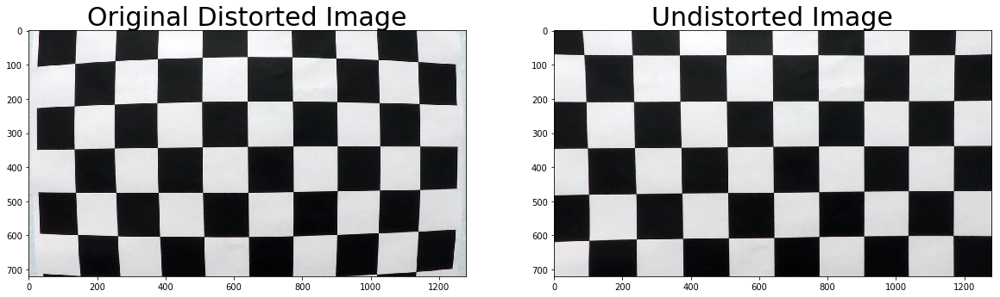

In [4]:
# Test undistortion on an image

import pickle

img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('output_images/calibration2.jpg', dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump(dist_pickle, open("camera_cal/dist_pickle.p", "wb"))

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Distorted Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

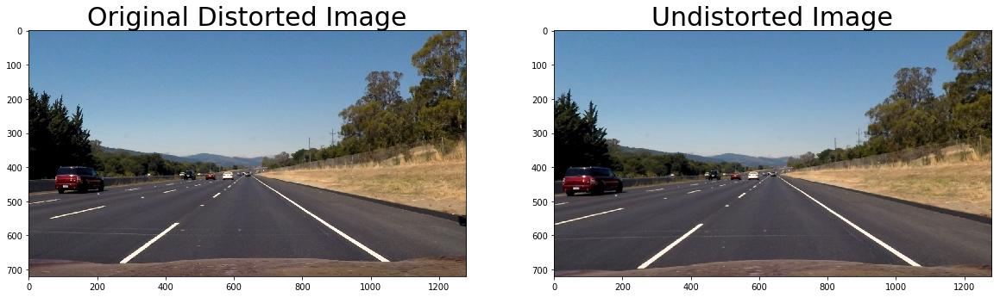

In [5]:
# creating function for undistort

def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)
    
# Test undistortion on an image
img = mpimg.imread('test_images/straight_lines2.jpg')

dst = undistort(img)

plt.imsave('output_images/undistorted_straight_lines2.jpg', dst)

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Distorted Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

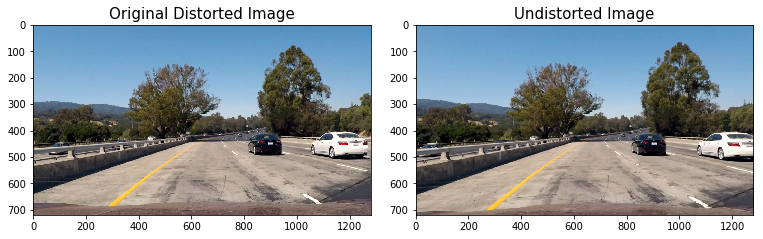

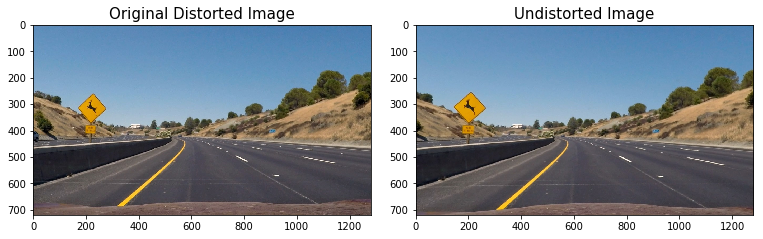

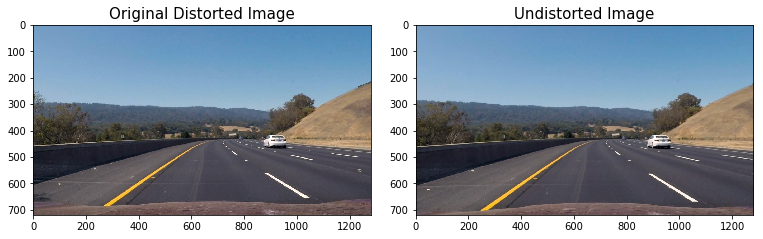

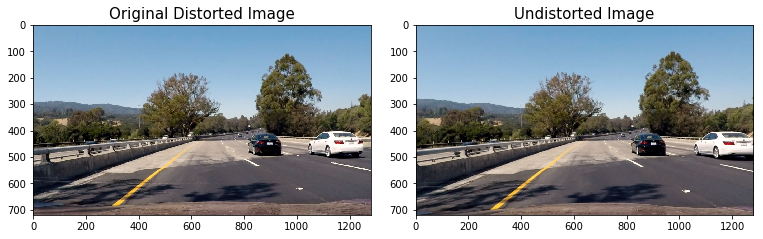

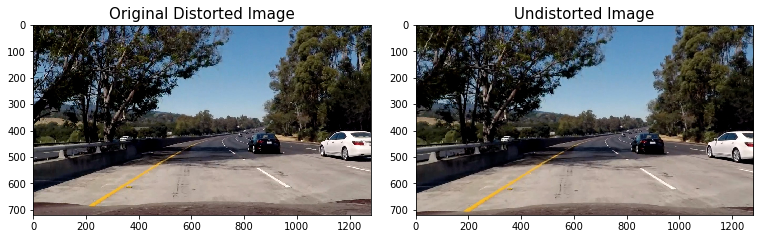

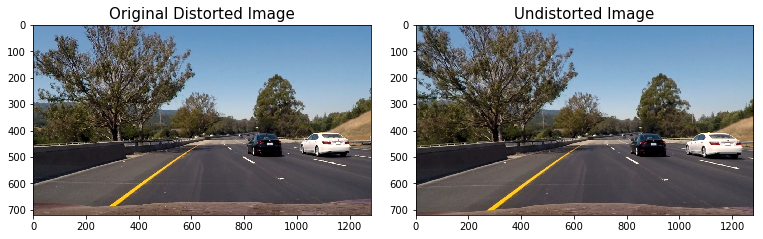

In [6]:
# lets try that on all the test images

test_images = glob.glob('test_images/test*.jpg')

undistorted_test_images = []

for idx, fname in enumerate(test_images):
    img = mpimg.imread(fname)
    dst = undistort(img)
    undistorted_test_images.append(dst)
    #plt.imsave('output_images/'undistorted_straight_lines2.jpg', dst)

    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Distorted Image', fontsize=15)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=15)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Grandient and Color Thresholding

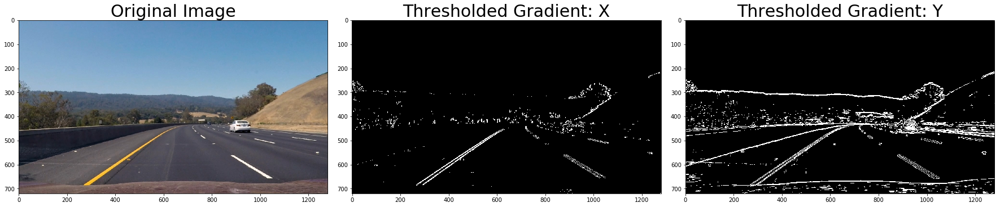

In [7]:
# Grandient along one axis:

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

# Read in an image and grayscale it
image = mpimg.imread('test_images/test3.jpg')

# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
    # is > thresh_min and < thresh_max
    thresh_min = thresh[0]
    thresh_max = thresh[1]
    
    sbinary = np.zeros_like(scaled_sobel)
    
    sbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # 6) Return this mask as your binary_output image
    return sbinary
    
# Run the function
grad_binary_x = abs_sobel_thresh(image, orient='x', sobel_kernel=9, thresh=(35, 100))
grad_binary_y = abs_sobel_thresh(image, orient='y', sobel_kernel=9, thresh=(20, 100))

# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(grad_binary_x, cmap='gray')
ax2.set_title('Thresholded Gradient: X', fontsize=30)
ax3.imshow(grad_binary_y, cmap='gray')
ax3.set_title('Thresholded Gradient: Y', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

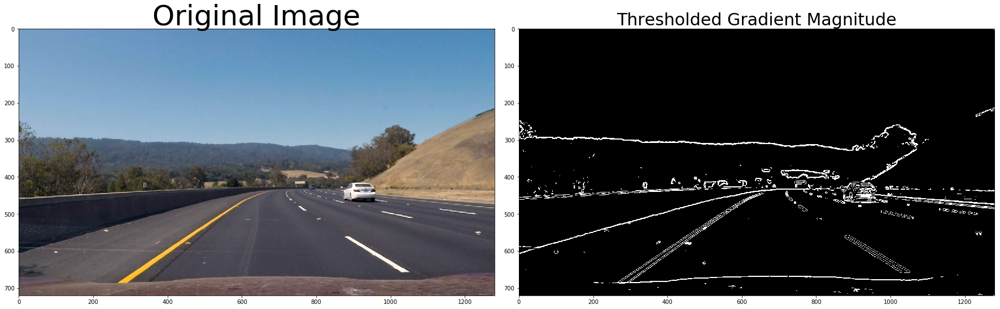

In [8]:
# Grandient magnitude

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

# Read in an image
image = mpimg.imread('test_images/test3.jpg')

# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    # 3) Calculate the magnitude 
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    abs_sobel = np.sqrt(np.square(abs_sobelx) + np.square(abs_sobely))
    
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 5) Create a binary mask where mag thresholds are met
    thresh_min = mag_thresh[0]
    thresh_max = mag_thresh[1]
    
    sbinary = np.zeros_like(scaled_sobel)
    
    sbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # 6) Return this mask as your binary_output image
    return sbinary
    
# Run the function
mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(40, 100))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Gradient Magnitude', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


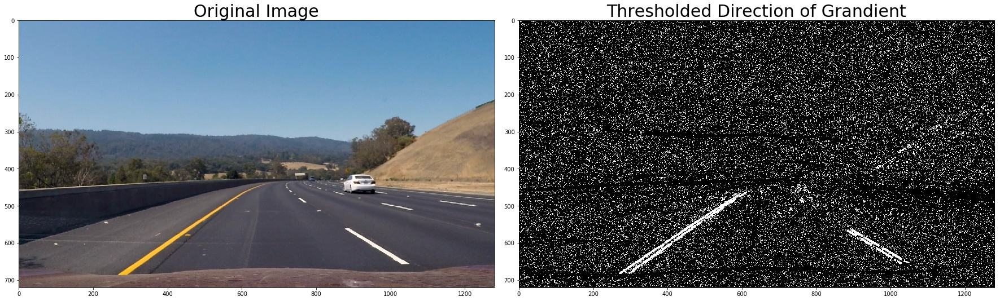

In [9]:
# Direction of the Gradient

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

# Read in an image
image = mpimg.imread('test_images/test3.jpg')

# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    dir = np.arctan2(abs_sobely, abs_sobelx)
    
    # 5) Create a binary mask where direction thresholds are met
    thresh_min = thresh[0]
    thresh_max = thresh[1]
    
    dir_binary = np.zeros_like(dir)

    dir_binary[(dir >= thresh_min) & (dir <= thresh_max)] = 1
    
    # 6) Return this mask as your binary_output image
    return dir_binary
    
# Run the function
dir_binary = dir_threshold(image, sobel_kernel=9, thresh=(0.9, 1.1))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Direction of Grandient', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

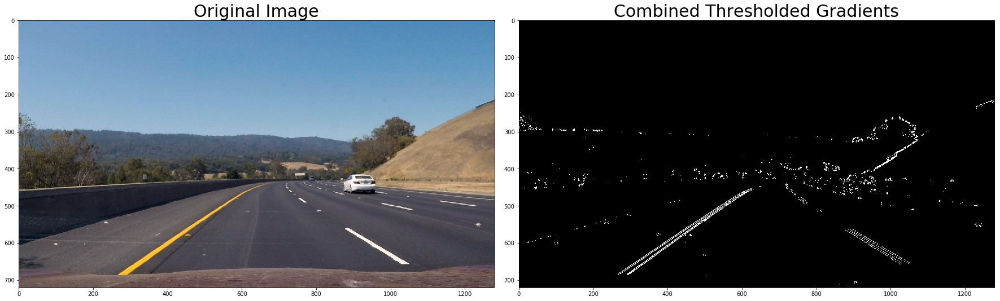

In [10]:
# combination of grandients

# Read in an image
image = mpimg.imread('test_images/test3.jpg')

ksize = 9

gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(35, 100))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(40, 100))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.9, 1.1))

combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Combined Thresholded Gradients', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

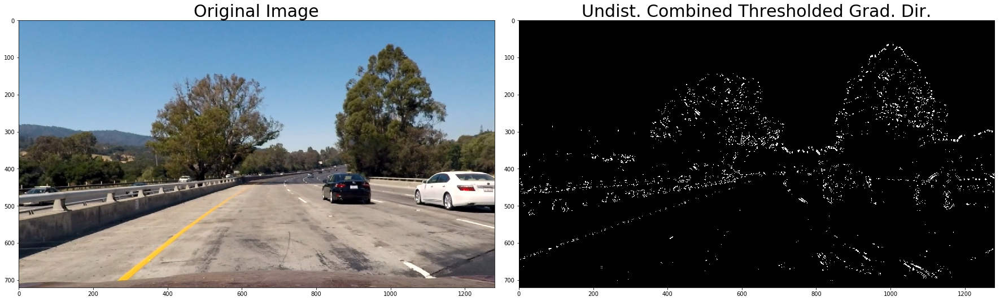

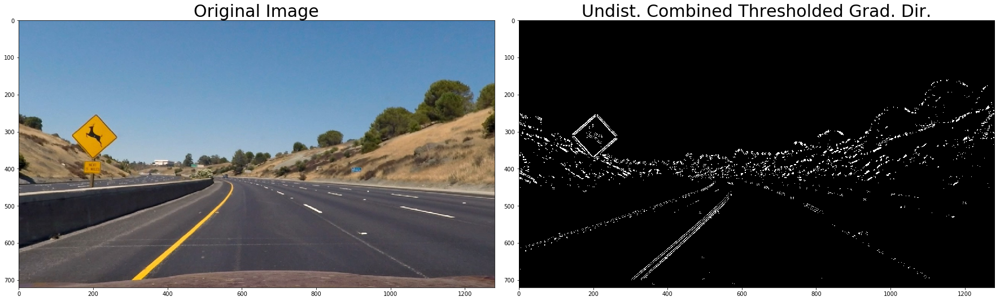

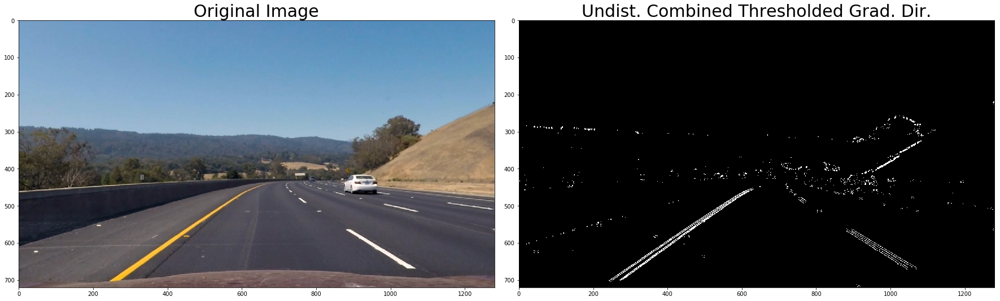

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


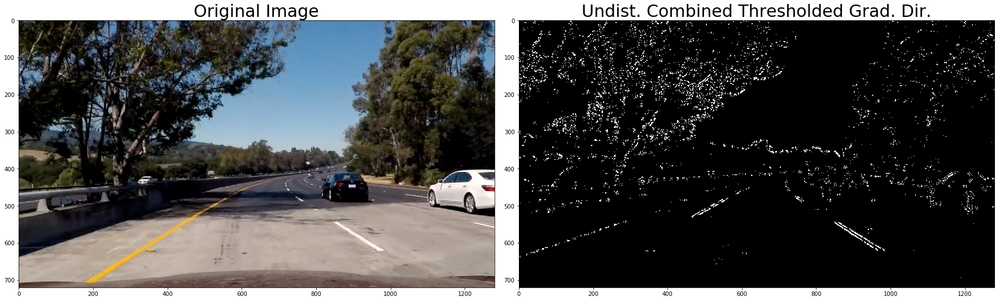

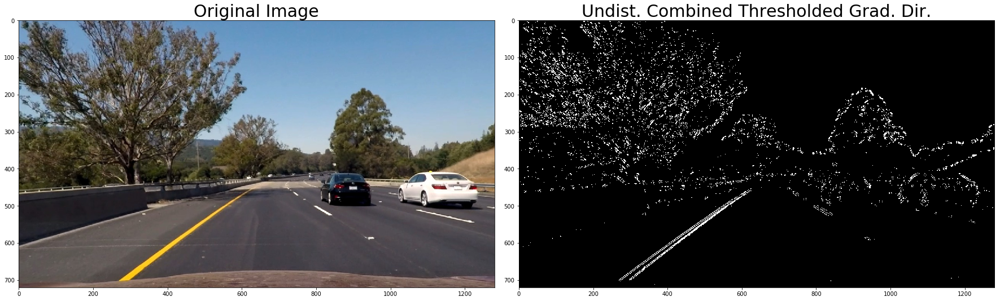

In [11]:
# combination of grandients for all test images

def apply_binary_thresholds(img, sobel_kernel = 9, thresh=(35, 100), dir_thresh=(0.9, 1.1)):
    
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=sobel_kernel, thresh=thresh)
    grady = abs_sobel_thresh(img, orient='y', sobel_kernel=sobel_kernel, thresh=thresh)
    mag_binary = mag_thresh(img, sobel_kernel=sobel_kernel, mag_thresh=thresh)
    dir_binary = dir_threshold(img, sobel_kernel=sobel_kernel, thresh=dir_thresh)

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    return combined


undistorted_thresholded_test_images = []

for idx, image in enumerate(undistorted_test_images):
    
    combined = apply_binary_thresholds(image)
    undistorted_thresholded_test_images.append(combined)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Undist. Combined Thresholded Grad. Dir.', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

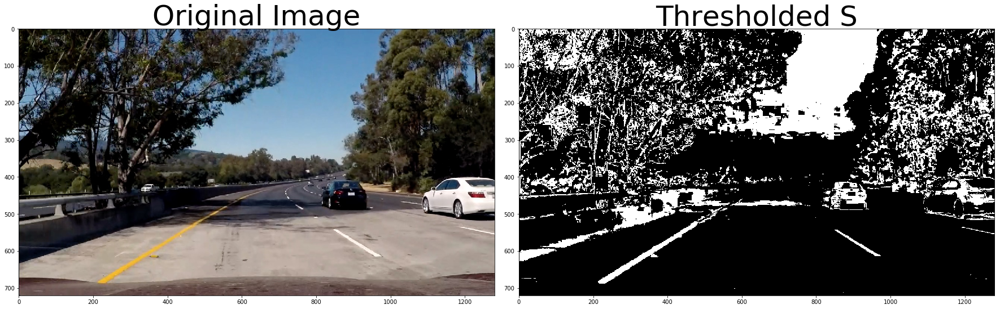

In [12]:
# Exploring different color spaces:

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2

# Read in an image, you can also try test1.jpg or test4.jpg
image = mpimg.imread('test_images/test5.jpg') 
#hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
#S = hls[:,:,2]
#print(np.max(S))

# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    binaryS = np.zeros_like(S)
    binaryS[(S > thresh[0]) & (S <= thresh[1])] = 1

    # 3) Return a binary image of threshold result
    return binaryS
    
hls_binary = hls_select(image, thresh=(100, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

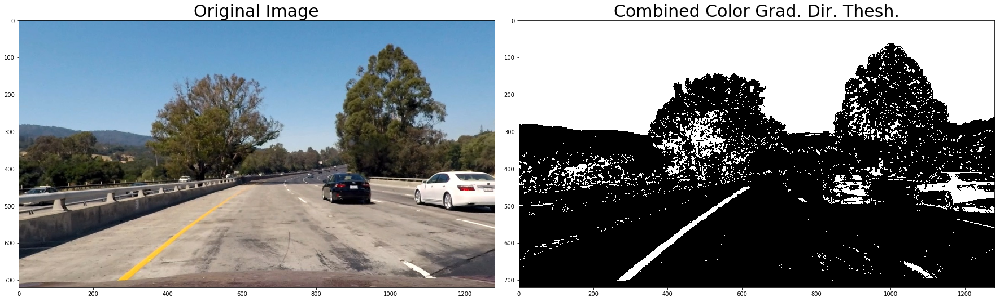

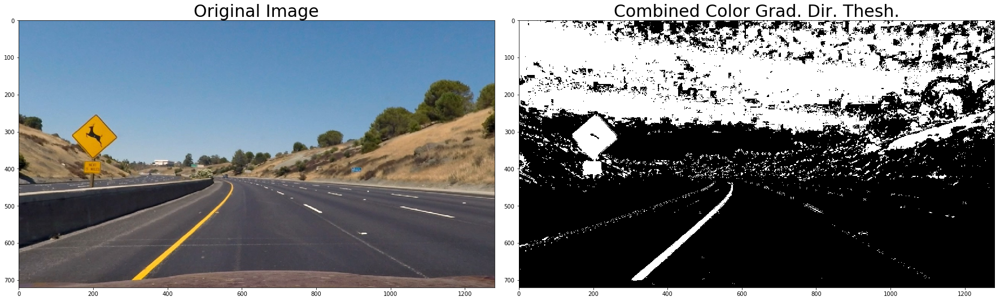

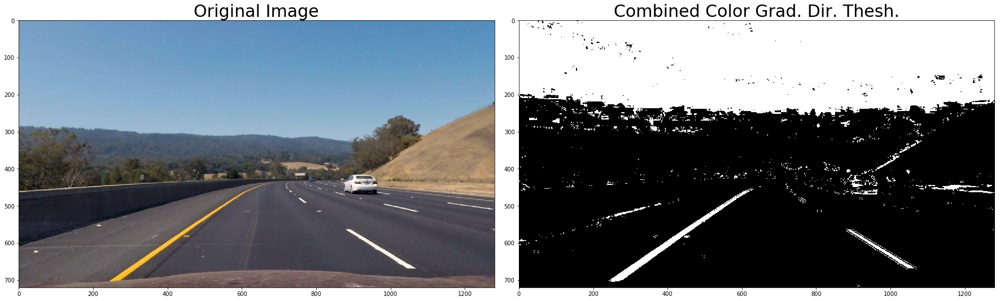

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


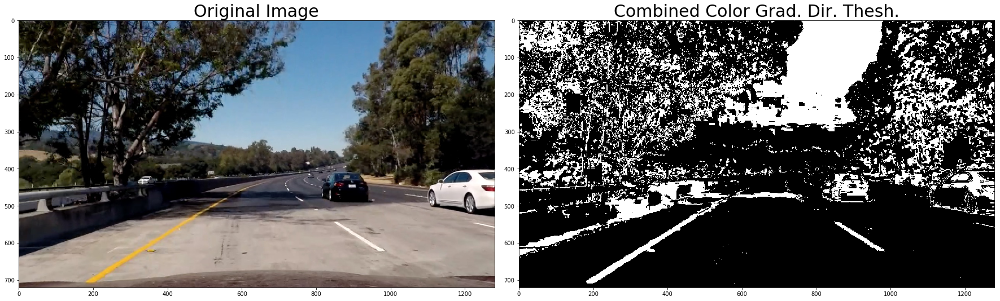

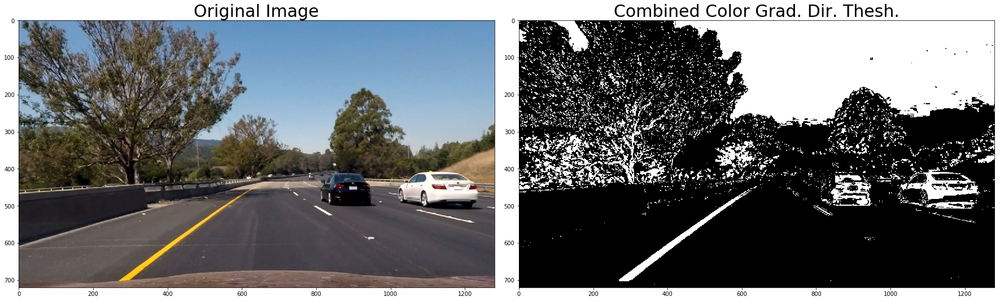

In [13]:
# combination of color and grandient thresholding

def combined_color_grad_threshold(img):
    
    grad = apply_binary_thresholds(img)
    hls_binary = hls_select(img, thresh=(100, 255))
    
    combined = np.zeros_like(hls_binary)
    combined[(grad == 1) | (hls_binary == 1)] = 1
    
    return combined
    
combined_thresholded_test_images = []

for idx, image in enumerate(undistorted_test_images):
    combined = combined_color_grad_threshold(image)
    combined_thresholded_test_images.append(combined)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined Color Grad. Dir. Thesh.', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

# Perspective Transform

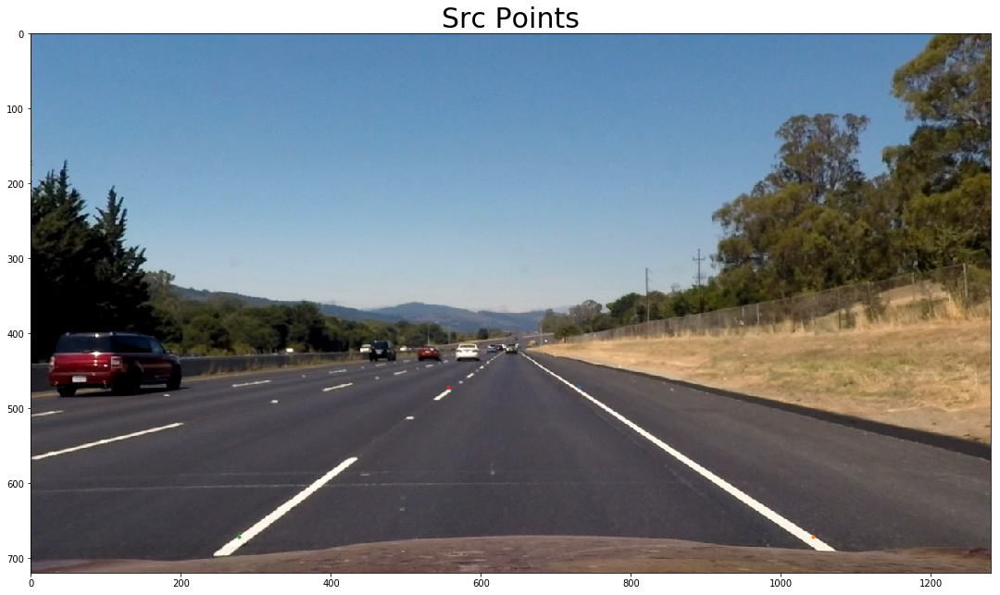

In [14]:
# Calculate pixel values from a straight line

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#%matplotlib qt

# Read in an image
image = mpimg.imread('output_images/undistorted_straight_lines2.jpg')
#plt.imshow(image)

# Plotting source image points

#plt.plot(672, 438,'.')
#plt.plot(1043,671,'.')
#plt.plot(277, 671,'.')
#plt.plot(607, 438,'.')




f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.plot(730, 472,'.')
ax1.plot(1043,671,'.')
ax1.plot(277, 671,'.')
ax1.plot(556, 472,'.')
ax1.set_title('Src Points', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

f.savefig('output_images/src_points.png')
    
# 241, 696
# 1081, 696

In [15]:

def warp(img):
    
    img_size = (img.shape[1], img.shape[0])
    
    src = np.float32(
    [
        [672, 438],
        [1043,671],
        [277, 671],
        [607, 438]
    ])
    
    src1 = np.float32(
    [
        [730, 472],
        [1043,671],
        [277, 671],
        [556, 472]
    ])
    
    dst = np.float32(
    [
        [1000,0],
        [1000,700],
        [250,700],
        [250,0]
    ])
    
    M1 = cv2.getPerspectiveTransform(src1, dst)
    
    M1inv = cv2.getPerspectiveTransform(dst, src1)
    
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped


In [16]:
# saving M and Minv for future

src1 = np.float32(
[
    [730, 472],
    [1043,671],
    [277, 671],
    [556, 472]
])

dst = np.float32(
[
    [1000,0],
    [1000,700],
    [250,700],
    [250,0]
])

M = cv2.getPerspectiveTransform(src1, dst)

Minv = cv2.getPerspectiveTransform(dst, src1)

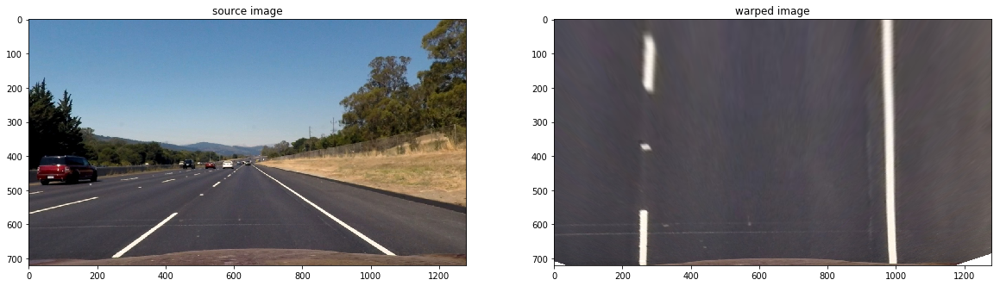

In [17]:
#%matplotlib inline

image = mpimg.imread('output_images/undistorted_straight_lines2.jpg')

warped_img = warp(image)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.set_title('source image')
ax2.set_title('warped image')
ax1.imshow(image)
ax2.imshow(warped_img)

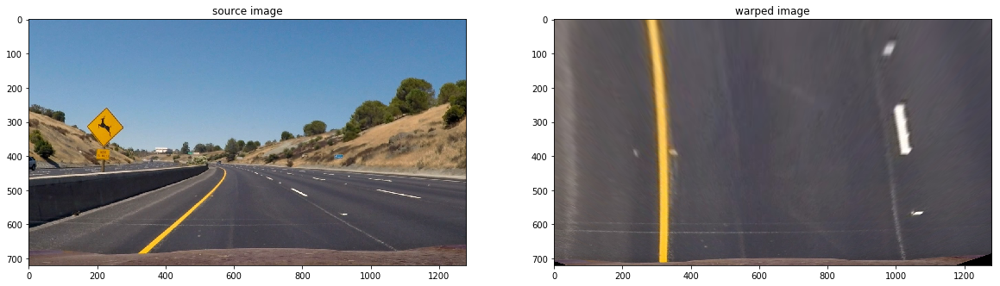

In [18]:
image = mpimg.imread('test_images/test2.jpg')

warped_img = warp(image)
plt.imsave('output_images/undistorted_straight_lines2.jpg', dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.set_title('source image')
ax2.set_title('warped image')
ax1.imshow(image)
ax2.imshow(warped_img)

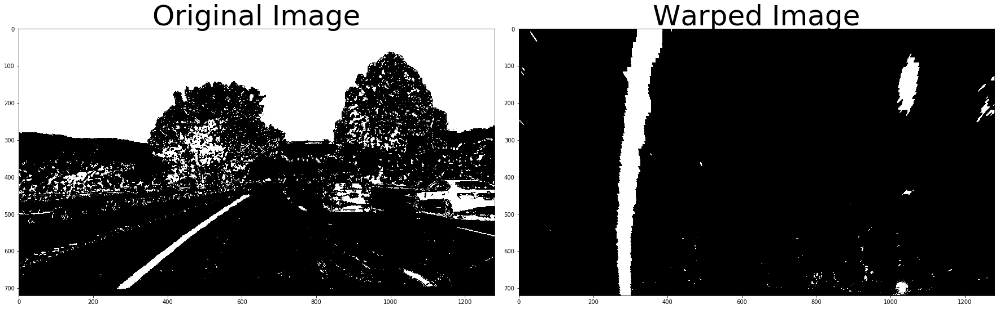

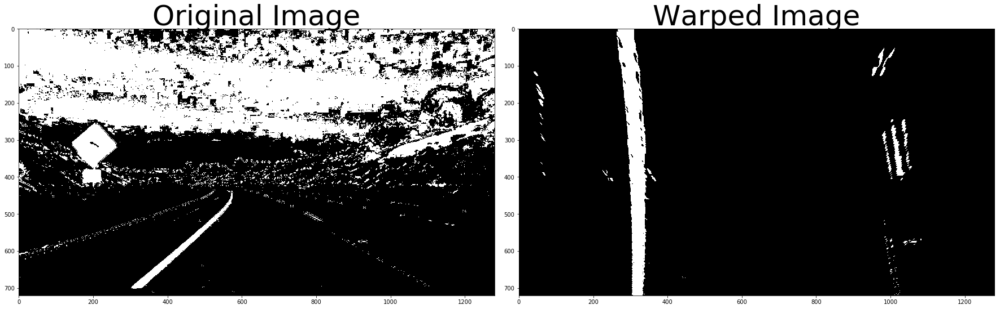

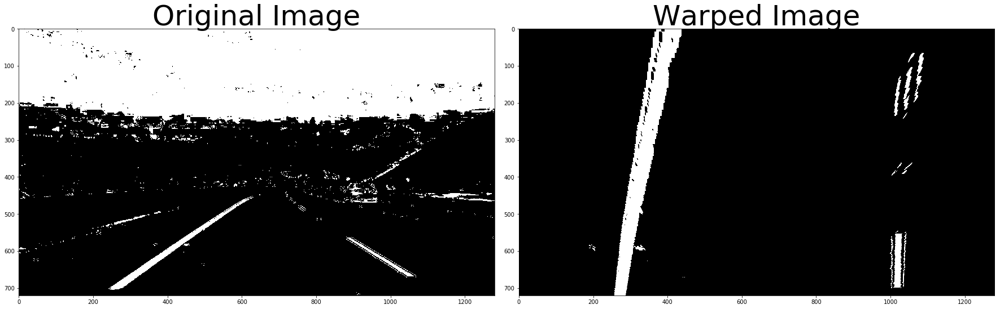

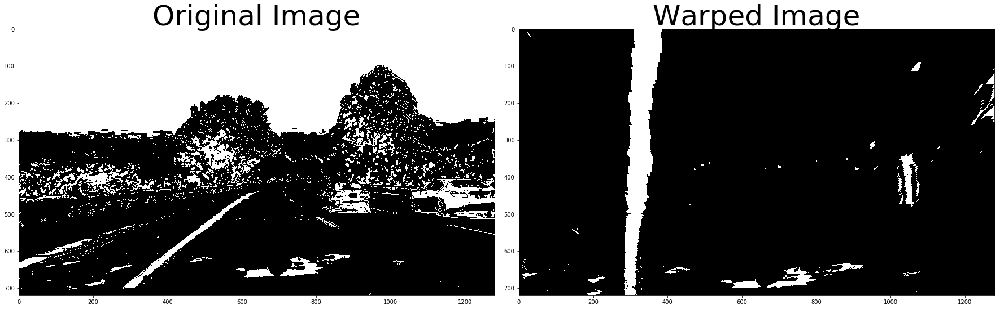

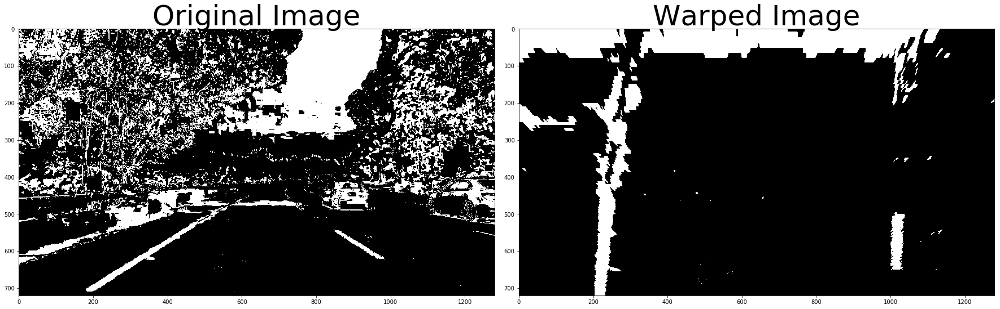

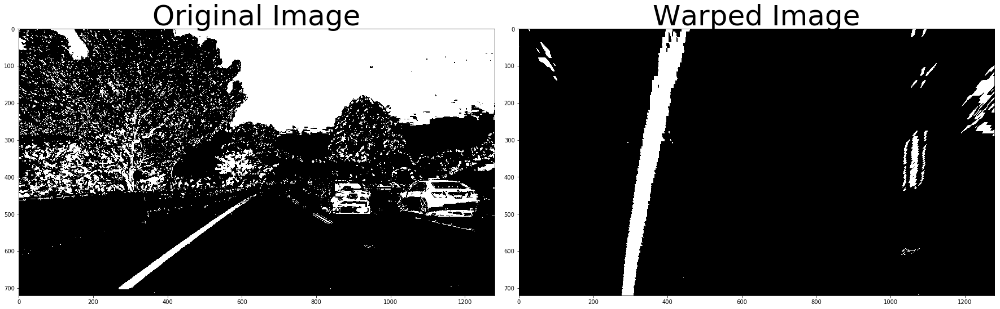

In [19]:

# combination 

final_test_images = []

for idx, image in enumerate(combined_thresholded_test_images):
    warped_img = warp(image)
    final_test_images.append(warped_img)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped_img, cmap='gray')
    ax2.set_title('Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

# Sliding Window and Fitting Polynomial

(720, 1280)
1
0
360
<class 'tuple'>
2
34857
34857
921600
0
0
266
267


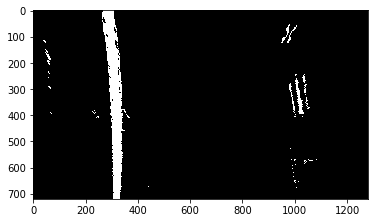

In [20]:
# example input image
binary_warped = final_test_images[1]
print(binary_warped.shape)
print(np.max(binary_warped))
print(np.min(binary_warped))
print(np.int(binary_warped.shape[0]/2))

plt.imshow(binary_warped, cmap='gray')

nonzero = binary_warped.nonzero()
print(type(nonzero))
print(len(nonzero))
print(len(nonzero[0]))
print(len(nonzero[1]))
print(720*1280)

print(nonzero[0][0])
print(nonzero[0][1])
print(nonzero[1][0])
print(nonzero[1][1])

(720, 1280)
[ -1.23591211e-04   1.34228951e-01   2.84982582e+02]
[ -2.91055379e-04   2.84107815e-01   9.54596981e+02]


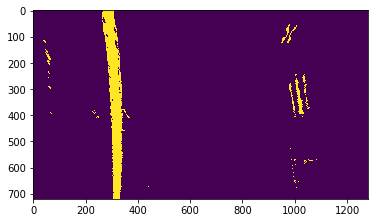

In [21]:
#Implement Sliding Windows and Fit a Polynomial

import numpy as np
import cv2
import matplotlib.pyplot as plt

def sliding_window_fit_poly(binary_warped):
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
    #print('histogram shape: ' + str(histogram.shape))
    
    # Create arightxn output image to draw on and  visualize the result
    #out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    # nonzero is a tuple of two arrays
    nonzero = binary_warped.nonzero()
    # nonzerox and nonzeroy is array of x and y indices of all nonzero elements
    # indices of all nonzero elements can be visualized as np.transpose(binary_warped.nonzero())
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Create empty lists to receive left and right lane pixel indices from all windows combined
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        #cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        #cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window
        # these are just indices in 1-dimensional nonzerox and nonzeroy arrays
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    # i.e. get actual indices of image from indices within nonzerox and nonzeroy
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds

plt.imshow(binary_warped)
print(binary_warped.shape)
left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(binary_warped)
print(left_fit)
print(right_fit)

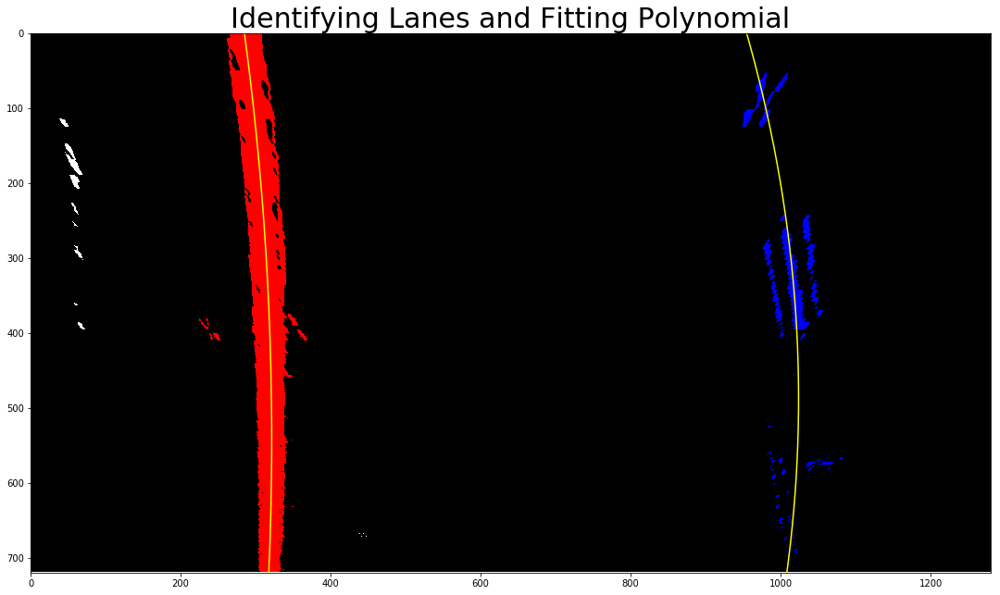

In [22]:
# Visualize

# Generate x and y values for plotting

#Return evenly spaced numbers over a specified interva
#(start, stop, num)
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
    
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
f.tight_layout()
ax1.imshow(out_img)

ax1.plot(left_fitx, ploty, color='yellow')
ax1.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

ax1.set_title('Identifying Lanes and Fitting Polynomial', fontsize=30)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

f.savefig('output_images/fit_poly.png')


In [23]:
# logic to skip full search and only look within margin of previous fit

def neighborhood_search_fit_poly(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds

left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(binary_warped)
binary_warped = final_test_images[2]
left_fit, right_fit, left_lane_inds, right_lane_inds = neighborhood_search_fit_poly(binary_warped, left_fit, right_fit)
print(left_fit)
print(right_fit)


[ -2.94303654e-05  -1.48490467e-01   3.88357091e+02]
[  2.09874054e-04  -2.22893295e-01   1.07541832e+03]


(720, 0)

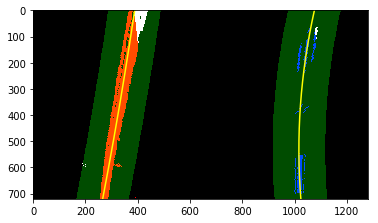

In [24]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
margin = 100
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
    
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

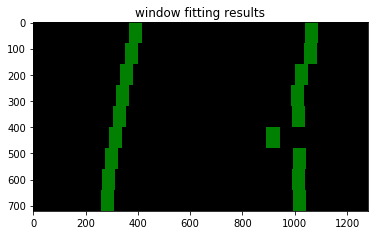

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import cv2

# Read in a thresholded image
warped = final_test_images[2] #binary_warped
#mpimg.imread('warped_example.jpg')
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
	    # convolve the window into the vertical slice of the image
	    image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
	    conv_signal = np.convolve(window, image_layer)
	    # Find the best left centroid by using past left center as a reference
	    # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
	    offset = window_width/2
	    l_min_index = int(max(l_center+offset-margin,0))
	    l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
	    l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
	    # Find the best right centroid by using past right center as a reference
	    r_min_index = int(max(r_center+offset-margin,0))
	    r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
	    r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
	    # Add what we found for that layer
	    window_centroids.append((l_center,r_center))

    return window_centroids

window_centroids = find_window_centroids(warped, window_width, window_height, margin)

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
	    l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
	    r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
	    # Add graphic points from window mask here to total pixels found 
	    l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
	    r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
# If no window centers found, just display orginal road image
else:
    output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

# Display the final results
plt.imshow(output)
plt.title('window fitting results')
plt.show()


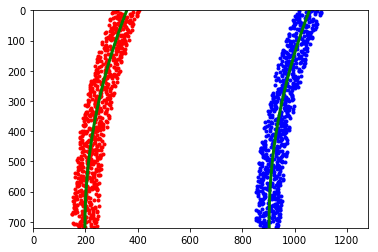

In [26]:
import numpy as np
import matplotlib.pyplot as plt
# Generate some fake data to represent lane-line pixels
ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
quadratic_coeff = 3e-4 # arbitrary quadratic coefficient
# For each y position generate random x position within +/-50 pix
# of the line base position in each case (x=200 for left, and x=900 for right)
leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                              for y in ploty])
rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                for y in ploty])

leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


# Fit a second order polynomial to pixel positions in each fake lane line
left_fit = np.polyfit(ploty, leftx, 2)
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fit = np.polyfit(ploty, rightx, 2)
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up the fake data
mark_size = 3
plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, ploty, color='green', linewidth=3)
plt.plot(right_fitx, ploty, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images

In [27]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
print(right_fit)

left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

print(left_fitx[0])
print(right_fitx[0])

print(left_fitx[350])
print(right_fitx[350])

print(left_fitx[710])
print(right_fitx[710])
print(y_eval)

print(left_fitx[np.int(y_eval)], right_fitx[np.int(y_eval)])
left_lane_offset = left_fitx[np.int(y_eval)]
right_lane_offset = right_fitx[np.int(y_eval)]
a = right_lane_offset - left_lane_offset - 625
b = a * 3.7 / 750
print(b)

1576.72036154 1569.52742514
[  3.18678561e-04  -4.42996259e-01   1.05649733e+03]
358.223167092
1056.4973321
239.480345067
940.486765124
198.403243693
902.61585071
719.0
198.42950417 902.727409351
0.391202998891


Radius of Curvature: 165.151602948, 128.880428472


(720, 0)

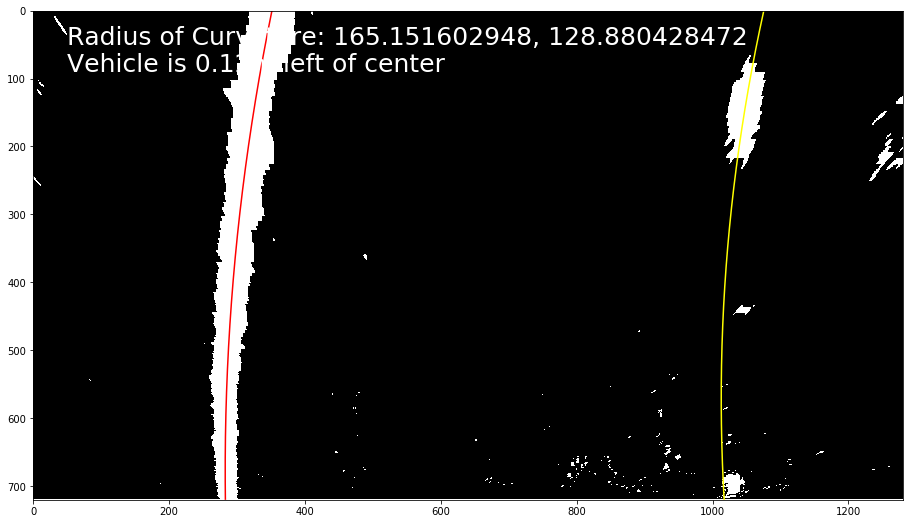

In [28]:
def compute_position(binary_warped, left_fit, right_fit):
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    y_eval = np.max(ploty)
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    left_lane_offset = left_fitx[np.int(y_eval)]
    right_lane_offset = right_fitx[np.int(y_eval)]
    
    ideal_center = 625
    current_center = left_lane_offset + (right_lane_offset - left_lane_offset)/2
    
    position_in_pixels =  ideal_center - current_center
    
    return position_in_pixels * 3.7 / 750

def compute_radius(binary_warped, left_fit, right_fit):
    ym_per_pix = 12/700 # meters per pixel in y dimension
    xm_per_pix = 3.7/625 # meters per pixel in x dimension
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    y_eval = np.max(ploty)

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Now our radius of curvature is in meters
    return left_curverad, right_curverad

def compute_radius1(binary_warped, left_fit, right_fit):
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    return left_curverad, right_curverad

binary_warped = final_test_images[0]
left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(binary_warped)
left_radius, right_radius = compute_radius(binary_warped, left_fit, right_fit)
position = compute_position(binary_warped, left_fit, right_fit)

#print(type(result))
text_str = "Radius of Curvature: " + str(left_radius) + ', ' + str(right_radius)
left_or_right = 'right'
if position < 0:
    left_or_right = 'left'
    
text_position = "Vehicle is " + "{0:0.2f}".format(abs(position)) + 'm ' + left_or_right + ' of center'
                                    
print(text_str)
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

#fig = plt.figure()
fig = plt.figure(figsize=(24, 9))
plt.imshow(binary_warped, cmap='gray')
plt.text(50,50, text_str, fontsize=25, color='white')
plt.text(50,90, text_position, fontsize=25, color='white')
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
plt.plot(left_fitx, ploty, color='red')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

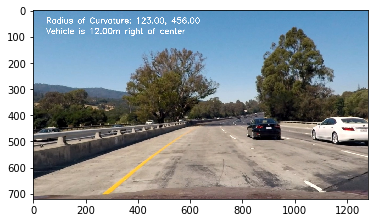

In [29]:
def draw_curvature_position(img, left_radius, right_radius, position):
    text_str = "Radius of Curvature: " + "{0:0.2f}".format(left_radius) + ', ' + "{0:0.2f}".format(right_radius)
    
    left_or_right = 'right'
    if position < 0:
        left_or_right = 'left'

    text_position = "Vehicle is " + "{0:0.2f}".format(abs(position)) + 'm ' + left_or_right + ' of center'

    cv2.putText(img, text_str, (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2,cv2.LINE_AA)
    cv2.putText(img, text_position, (50,90), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2,cv2.LINE_AA)
    
    #return img

img = undistorted_test_images[0]
draw_curvature_position(img, 123, 456, 12)
plt.imshow(img)

In [30]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

517.853784949 m 515.33950009 m


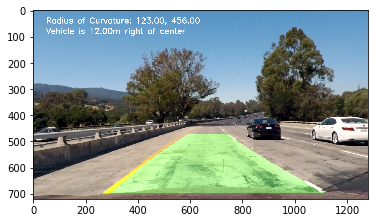

In [31]:
# Create an image to draw the lines on
binary_warped = final_test_images[2]
warped = binary_warped

left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(warped)
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undistorted_test_images[0], 1, newwarp, 0.3, 0)
plt.imshow(result)

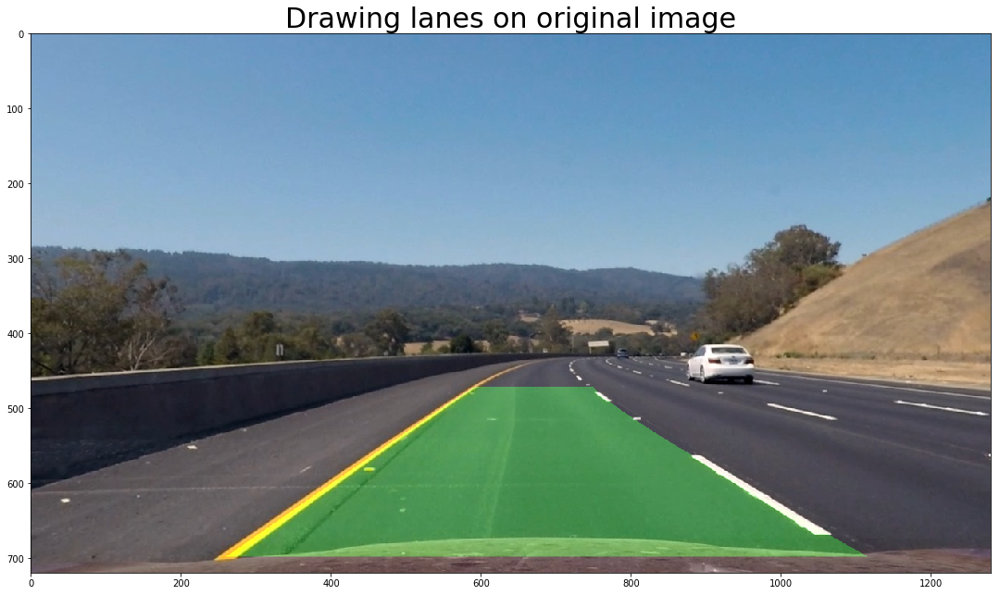

In [32]:
def draw_lanes(original_image, binary_warped, left_fit, right_fit):
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(original_image, 1, newwarp, 0.3, 0)
    
    return result

binary_warped = final_test_images[2]
left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(warped)
result = draw_lanes(undistorted_test_images[2], binary_warped, left_fit, right_fit)

f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
f.tight_layout()
ax1.imshow(result)
ax1.set_title('Drawing lanes on original image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
f.savefig('output_images/draw_lanes.png')



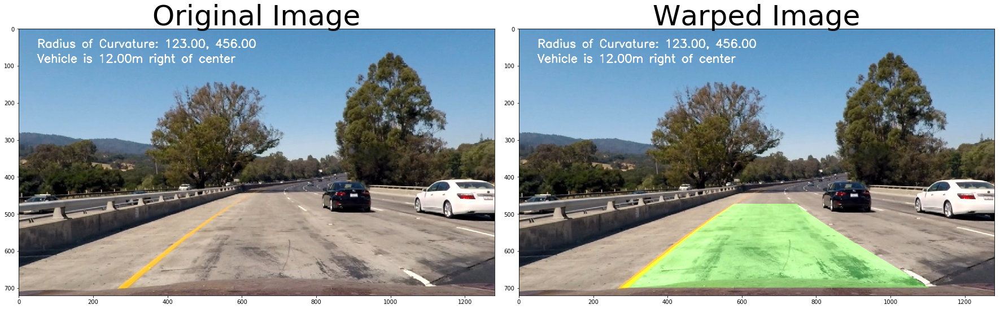

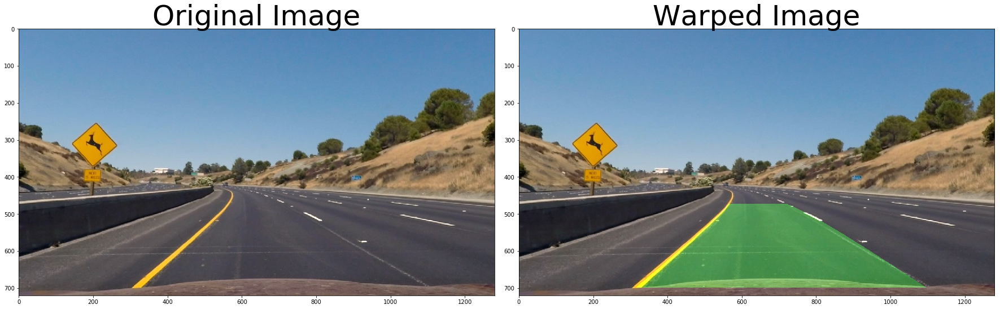

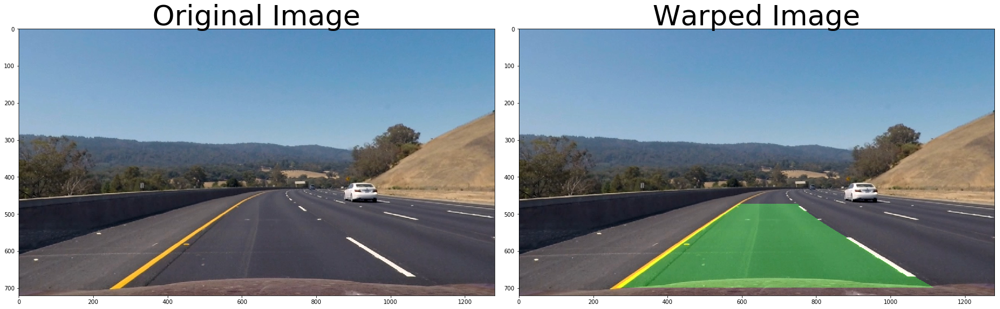

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


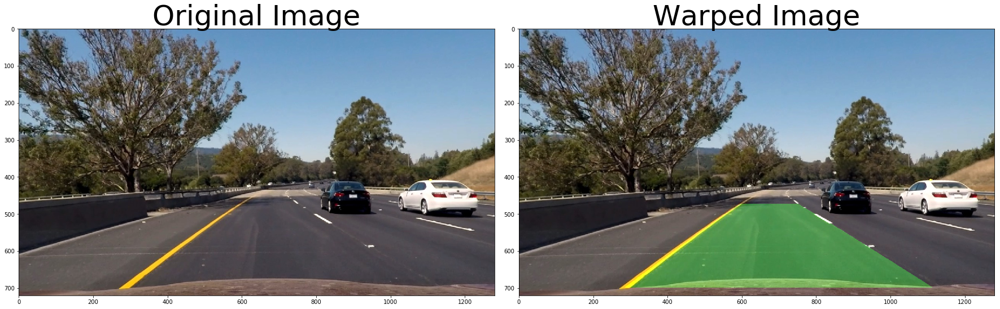

In [33]:
# combination 

for idx, image in enumerate(final_test_images):
    left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(image)
    result = draw_lanes(undistorted_test_images[idx], image, left_fit, right_fit)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(undistorted_test_images[idx])
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(result)
    ax2.set_title('Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

In [34]:
test_images

['test_images\\test1.jpg',
 'test_images\\test2.jpg',
 'test_images\\test3.jpg',
 'test_images\\test4.jpg',
 'test_images\\test5.jpg',
 'test_images\\test6.jpg']

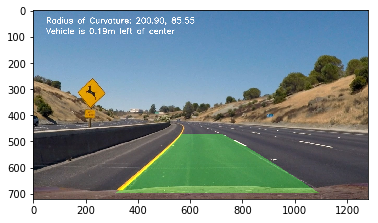

In [35]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    
    #reading in an image
    #image = mpimg.imread(imageFileName)

    # Step1 - undistorting the image
    undistorted = undistort(image)
    
    # Step2 - thresholding the image
    thresh = combined_color_grad_threshold(undistorted)
    
    # Step3 - perspective transforming the image
    warped = warp(thresh)
    
    # Step4 - fitting polynomial to the image
    left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(warped)
    
    # Step5 - calculate curvature of the image
    left_radius, right_radius = compute_radius(warped, left_fit, right_fit)
    position = compute_position(warped, left_fit, right_fit)
    draw_curvature_position(image, left_radius, right_radius, position)
    
    # Step6 - drawing lanes on the image
    result = draw_lanes(image, warped, left_fit, right_fit)
    
    return result

test_img = mpimg.imread(test_images[1])
plt.imshow(test_img)
#gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#plt.imshow(gray, cmap='gray')
result = process_image(test_img)
plt.imshow(result)

(720, 1280, 3)


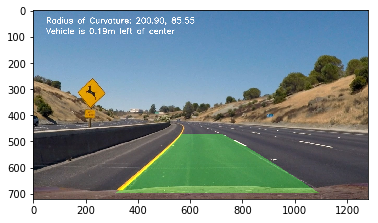

In [36]:
plt.imshow(result)
print(result.shape)
thresh = combined_color_grad_threshold(result)

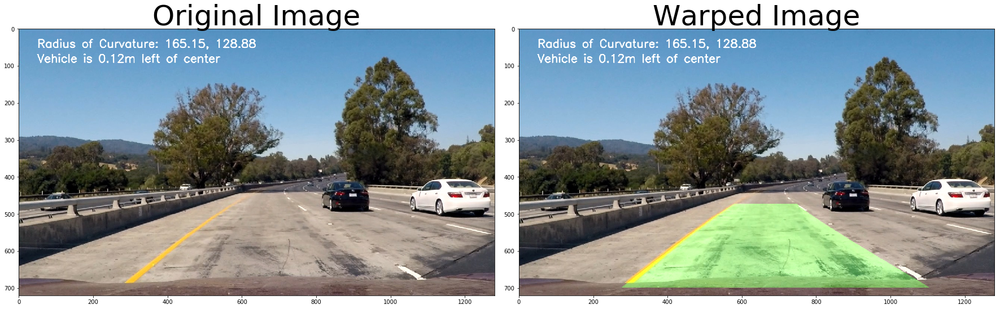

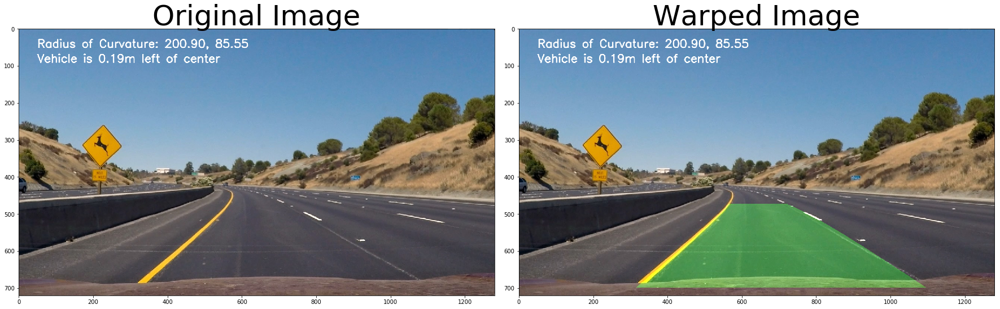

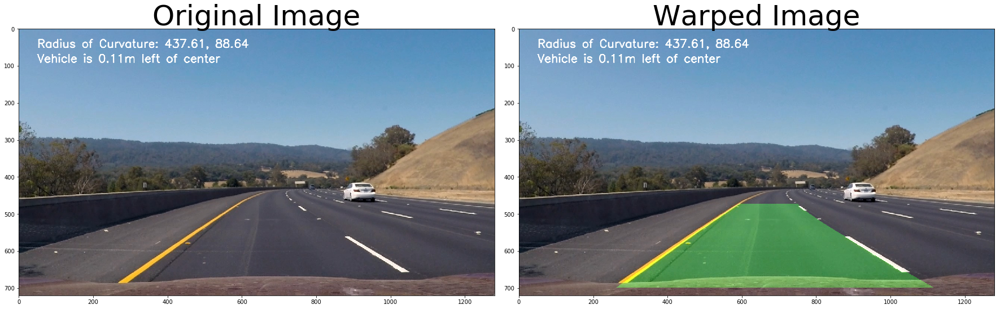

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


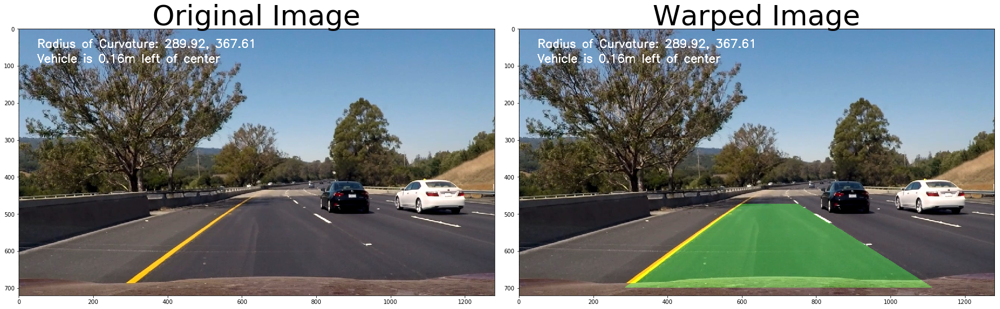

In [37]:
for idx, fname in enumerate(test_images):
    img = mpimg.imread(fname)
    result = process_image(img)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(result)
    ax2.set_title('Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [58]:
def get_avg_fit(saved_fits):
    sum_fit = np.zeros_like(saved_fits[0])
    for i in range(len(saved_fits)):
        sum_fit += saved_fits[i]
        
    return sum_fit/len(saved_fits)
        

In [59]:
num_frames_history = 5
#index = []
saved_left_fit = []
saved_right_fit = []

In [60]:

def process_image2(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    
    # Step1 - undistorting the image
    undistorted = undistort(image)
    
    # Step2 - thresholding the image
    thresh = combined_color_grad_threshold(undistorted)
    
    # Step3 - perspective transforming the image
    warped = warp(thresh)
    
    # Step4 - fitting polynomial to the image
    if len(saved_left_fit) <= num_frames_history:
        left_fit, right_fit, left_lane_inds, right_lane_inds = sliding_window_fit_poly(warped)
        index.append(1)
        saved_left_fit.append(left_fit)
        saved_right_fit.append(right_fit)
    else:
        left_fit = get_avg_fit(saved_left_fit)
        right_fit = get_avg_fit(saved_right_fit)
        saved_left_fit.pop(0)
        saved_right_fit.pop(0)
        left_fit, right_fit, left_lane_inds, right_lane_inds = neighborhood_search_fit_poly(warped, left_fit, right_fit)
        saved_left_fit.append(left_fit)
        saved_right_fit.append(right_fit)
    
    left_fit = get_avg_fit(saved_left_fit)
    right_fit = get_avg_fit(saved_right_fit)
        
    # Step5 - calculate curvature of the image
    left_radius, right_radius = compute_radius(warped, left_fit, right_fit)
    position = compute_position(warped, left_fit, right_fit)
    draw_curvature_position(image, left_radius, right_radius, position)
    
    # Step6 - drawing lanes on the image
    result = draw_lanes(image, warped, left_fit, right_fit)
    
    return result




In [ ]:
test_img = mpimg.imread(test_images[1])
plt.imshow(test_img)
#gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#plt.imshow(gray, cmap='gray')
result = process_image2(test_img)
plt.imshow(result)

In [50]:
print(index)
print(saved_left_fit)
print(saved_right_fit)

[1]
[array([ -1.23591211e-04,   1.34228951e-01,   2.84982582e+02])]
[array([ -2.91055379e-04,   2.84107815e-01,   9.54596981e+02])]


In [62]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

output_video = 'output_project_video_final.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")#.subclip(38,45)
output_clip = clip1.fl_image(process_image2) #NOTE: this function expects color images!!
%time output_clip.write_videofile(output_video, audio=False)
clip1.reader.close()
clip1.audio.reader.close_proc()

[MoviePy] >>>> Building video output_project_video_final.mp4
[MoviePy] Writing video output_project_video_final.mp4


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 1260/1261 [07:31<00:00,  3.07it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_project_video_final.mp4 

Wall time: 7min 32s


In [41]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_video))